In [97]:
import re
import math
import pandas as pd
import numpy as np
import matplotlib.animation as animation
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from tqdm import tqdm

pd.set_option('display.max_columns', 1000)
pd.set_option('display.max_colwidth', 1000)
pd.set_option('display.max_rows', 1000)
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()

In [2]:
games = pd.read_csv("./data/games.csv")
players = pd.read_csv("./data/players.csv")
plays = pd.read_csv("./data/plays.csv")
weeks = [] 
for i in range(1,18):
    weeks.append(pd.read_csv("./data/week{}.csv".format(i)))

In [3]:
def get_week_df(gameID, playID):
    wk = games.query("gameId=={}".format(gameID)).iloc[0].week
    week_df = weeks[wk-1]
    information = week_df[(week_df.playId==playID)&(week_df.gameId==gameID)]
    return information, wk

# this function requires 'plays' dataframe
def animate_play(gameID, playID):
    plt.close('all')
    fig, ax = plt.subplots()
    fig.set_figheight(7)
    fig.set_figwidth(14)
    
    information, wk = get_week_df(gameID, playID)
    max_frame = information.frameId.max()
    print("GAME: {}\tPLAY: {}\tWEEK: {}\tFRAME: {}".format(gameID, playID, wk, max_frame))
    
    home, = ax.plot([],[], linestyle='None', marker='o', markersize=12, c='C0')
    away, = ax.plot([],[], linestyle='None', marker='o', markersize=12, c='C1')
    foot, = ax.plot([],[], linestyle='None', marker='o', markersize=12, c='C2')
    lines = [home, away, foot]
    
    def draw_field():
        ax.set_xlim(0, 120)
        ax.set_ylim(-5, 58.3)
        # Endzones
        ax.add_patch(Rectangle((  0, 0), width=10, height=53.3, alpha=0.5, color='grey'))
        ax.add_patch(Rectangle((110, 0), width=10, height=53.3, alpha=0.5, color='grey'))
        # Sidelines
        ax.plot([0,120],[0,0], c='grey', linewidth=2)
        ax.plot([0,120],[53.3,53.3], c='grey', linewidth=2)
        for i in range(10, 120, 10):
            # 10 Yard lines
            ax.plot([i,i],[0,53.3], c='grey', linewidth=2)
            if abs(60-i) <=40:
                # Numbers
                ax.text(i-2.5, 12, str(50-abs(60-i)), color="grey", fontsize=24)
                ax.text(i-2.5, 41.3, str(50-abs(60-i)), color="grey", fontsize=24, rotation=180)
        # Hash marks
        for i in range(10, 110):
            ax.plot([i,i], [0, 1], c='grey')
            ax.plot([i,i], [23, 24], c='grey')
            ax.plot([i,i], [29.3, 30.3], c='grey')
            ax.plot([i,i], [52.3, 53.3], c='grey')
        
        # Drawing the line of scrimmage
        scrimmage = information.query("frameId==1 and displayName=='Football'").iloc[0].x
        ax.plot([scrimmage,scrimmage],[0, 53.3], c='darkblue', linewidth=2)
        
        # Drawing the First Down Line
        play_information = plays.query("playId=={} and gameId=={}".format(playID, gameID)).iloc[0]
        ax.set_title(play_information.playDescription)
        home_team = games[games.gameId==gameID].iloc[0].homeTeamAbbr
        poss_team = play_information.possessionTeam
        team_query_term = "home"
        if home_team != poss_team:
            team_query_term = "away"
        shit = information.query("frameId==1 and team=='{}'".format(team_query_term)).iloc[0].x
        first_down_line = scrimmage - play_information.yardsToGo
        if shit < scrimmage:
            first_down_line = scrimmage + play_information.yardsToGo
        ax.plot([first_down_line,first_down_line],[0, 53.3], c='gold', linewidth=2)
        return lines

    def plot_players(t):
        home_filtered = information[(information.frameId==t)&(information.team=="home")]
        away_filtered = information[(information.frameId==t)&(information.team=="away")]
        foot_filtered = information[(information.frameId==t)&(information.team=="football")]
        home.set_data(home_filtered.x.array, home_filtered.y.array)
        away.set_data(away_filtered.x.array, away_filtered.y.array)
        foot.set_data(foot_filtered.x.array, foot_filtered.y.array)
        lines = [home, away, foot]
        
        if t%10 == 0:
            print(t,end = ',')
        return lines
    
    return animation.FuncAnimation(fig, plot_players, frames=range(1, max_frame+1), init_func=draw_field, blit=True)
    #return animation.FuncAnimation(fig, plot_players, frames=range(20, 21), init_func=draw_field, blit=True)

# Longest Play

In [4]:
# Longest Plays
sorted(plays.playResult.array, reverse=True)[:10]

[97, 90, 89, 85, 83, 82, 82, 80, 79, 78]

In [5]:
# Longest Play
some_play = plays[plays.playResult == 97].iloc[0]
animate_play(some_play.gameId, some_play.playId)

GAME: 2018112509	PLAY: 2475	WEEK: 12	FRAME: 148
10,20,30,40,50,60,70,80,90,100,110,120,130,140,

# Shortest Play

In [6]:
# Shortest Plays
sorted(plays.playResult.array, reverse=False)[:10]

[-78, -70, -69, -66, -66, -64, -51, -51, -41, -39]

In [7]:
some_play = plays[plays.playResult == -78].iloc[0]
animate_play(some_play.gameId, some_play.playId)

GAME: 2018120200	PLAY: 1199	WEEK: 13	FRAME: 189
10,20,30,40,50,60,70,80,90,100,110,120,130,140,150,160,170,180,

# Given a play, find the match up that is being targeted
# Method 1: use number of frames and proximity to the ball
Let's only look at the matchup that is being targeted. Here is the game and play id for a random pass play

In [8]:
sampled = plays.query("playType=='play_type_pass'").sample(1).iloc[0]
animate_play(sampled.gameId, sampled.playId)

GAME: 2018120600	PLAY: 1928	WEEK: 14	FRAME: 68
10,20,30,40,50,60,

So we need to figure out who the ball is the most nearest to. We can see that the play is from week 1. so we pull the relevant week df:

In [9]:
wk = games.query("gameId=={}".format(sampled.gameId)).iloc[0].week
currplay = weeks[wk-1].query("gameId=={} and playId=={}".format(sampled.gameId, sampled.playId))
count = {}
for i in range(len(currplay)):
    p = currplay.iloc[i]
    if p.position == "QB" or p.displayName=="Football":
        continue
    b = currplay.query("frameId=={} and displayName=='Football'".format(p.frameId)).iloc[0]
    d = math.sqrt((p.x-b.x)**2+(p.y-b.y)**2)
    if d < 1.5:
        key = p.displayName + ", " + p.position
        if key not in count:
            count[key] = 0
        count[key] += 1
print(count)

{'Corey Davis, WR': 25, 'Ronnie Harrison, DB': 8, 'D.J. Hayden, CB': 2}


# Method 2: parse the 'playDescription' 
Parse the name of the targeted receiver from the 'playDescription', and match it to plays.csv or week\d.csv to find the full name.

In [81]:
initial_re = " (to|for) [A-Z]{1}[a-z]*\.\s?[A-Z]{1}[-\'a-zA-Z]+[\s\.$]+"
name_re =              "[A-Z]{1}[a-z]*\.\s?[A-Z]{1}[-\'a-zA-Z]+[\s\.$]+"
filt = plays.playDescription.str.contains(initial_re, regex=True)
full_names = []
for i in tqdm(range(len(filt))):
    full_name = "-"
    if "E.St. Brown" in plays.iloc[i].playDescription:
        full_name = "Equanimeous St. Brown"
    elif filt.iloc[i]:
        shit = re.search(initial_re, plays.iloc[i].playDescription).group(0)
        target = re.search(name_re, shit).group(0).split(".")
        
        if target[-1] == '':
            target.pop(-1)
        
        # Get the appropriate week\d.csv
        result, wk = get_week_df(plays.iloc[i].gameId, plays.iloc[i].playId)
        
        # filter by the qb's team, if there is a qb on the field
        something = result.query("position=='QB'")
        if len(something) > 0:
            qb_team = something.team.iloc[0]
            result = result[result.team==qb_team]
        
        # filter for names that match
        spec_name_re = "^{}[-\'\.a-zA-Z]+ {}$".format(target[0].strip(), target[1].strip())
        result = result[result.displayName.str.contains(spec_name_re, regex=True)].displayName.unique().tolist()
        if len(result) == 0:
            players_result = players[players.displayName.str.contains(spec_name_re, regex=True)]
            if len(players_result) > 1:
                # we see if other plays with the matching name, use that name
                potential = pd.Series(weeks[wk-1][weeks[wk-1].gameId==plays.iloc[i].gameId].displayName.unique().tolist())
                potential = potential[potential.str.contains(spec_name_re, regex=True)]
                if len(potential) != 1:
                    print(target)
                    print(potential)
                    print(wk, plays.iloc[i].gameId, plays.iloc[i].playId)
                    print(plays.iloc[i].playDescription)
                    print("UNCAUGHT ERROR 11111111111111111111111111111111111111111111111111111111111")
                else:
                    full_name = potential.iloc[0]
            elif len(players_result) == 1:
                full_name = players_result.iloc[0].displayName
            # When len(players_result)==0, it means that the targeted player is not a usually targeted player (LB and etc)
            # so we ignore this case
            
        else:
            full_name = result[0]
        # there aren't any cases where len(result) > 1. I've checked already
    full_names.append(full_name)
plays = plays.assign(target=full_names)

C:\Users\Aaron\anaconda3\envs\flowenv\lib\site-packages\pandas\core\strings.py:2001: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  return func(self, *args, **kwargs)
100%|███████████████████████████████████████████████████████████████████████████| 19239/19239 [02:17<00:00, 140.03it/s]


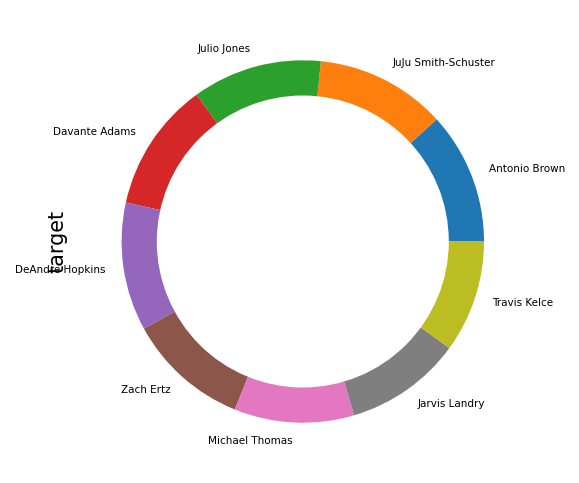

In [136]:
plt.close('all')
top_k = 10

shit = plays.target.value_counts()
shit.iloc[0] += shit[top_k:].sum()
shit = shit[1:top_k]
shat = shit.plot.pie(textprops={'fontsize': 5})
shat.set_xticklabels(shat.xaxis.get_majorticklabels(), rotation=45, ha='right')

my_circle=plt.Circle( (0,0), 0.8, color='white')
p=plt.gcf()
p.gca().add_artist(my_circle)

plt.show()